### Assignment 3 : Linear Regression

I am using the King County Housing Data set. It has 21613 rows and has 21 features. There is a mix of quantitative and qualitative feautres.

I have applied different models and covered the following topics:
 - Exploratory data analysis
 - Association between independent and dependent variables
 - Discuss model assumptions
 - Compare and evaluate models
 - Correlation between independent variables
 - Dummy variable creation for binary as well multli-class qualitative variables
 - Calculation of model evaluation metrics like : R2, Adjusted R2, p-value, AIC, BIC
 - Interaction term
 - Regularization
     - Lasso
     - Ridge Regression
 - Cross Validation
 - Step Wise Regression - Forward Regression
 - KNN Regression(Just to explore how it performs and how different is it from linear regression)
 

<img src="https://i.imgur.com/kCNAFTN.jpg?1">

In [1]:
# Importing the modules 
import numpy as np
import pandas as pd 
pd.set_option('display.max_columns', None) # To display all columns
from sklearn.model_selection import train_test_split
from sklearn import linear_model
from sklearn.neighbors import KNeighborsRegressor
from sklearn.preprocessing import PolynomialFeatures
from sklearn import metrics
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
from mpl_toolkits.mplot3d import Axes3D
import plotly.plotly as py
import plotly.graph_objs as go
import folium # for map visualization
from folium import plugins
from folium.plugins import MarkerCluster
from scipy import stats, linalg
from sklearn import preprocessing # provides functions and classes to change raw feature vectors
from sklearn.metrics import mean_squared_error # Mean squared error regression loss
from sklearn import neighbors # provides functionality for unsupervised and supervised neighbors-based learning methods
from math import log
import warnings
warnings.filterwarnings('ignore') # To ignore some of seaborn warning msg
%matplotlib inline

In [2]:
## Loading the dataset and handling categorical variables.
evaluation = pd.DataFrame({'Model': [],
                           'Details':[],
                           'Mean Squared Error (MSE)':[],
                           'R-squared (training)':[],
                           'Adjusted R-squared (training)':[],
                           'R-squared (test)':[],
                           'Adjusted R-squared (test)':[],
                           'AIC': [],
                           'BIC': [] })

# Reading Data 
df = pd.read_csv('kc_house_data-1.csv')
df['view'] = df['view'].astype('category',ordered=True)
df['condition'] = df['condition'].astype('category',ordered=True)
df['grade'] = df['grade'].astype('category',ordered=False)
df['zipcode'] = df['zipcode'].astype(str)
df['waterfront'] = df['waterfront'].astype('category', ordered=False)
df = df.sort_values('date')

df.head()
#df.grade.dtype
#df.columns

#Creating a dataFrame with important columns
df_refined = df[['sqft_living', 'bedrooms', 'bathrooms', 'floors', 'grade', 'yr_built', 'zipcode']].copy()


### EDA

In [3]:
df.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15
count,2.161300e+04,2.161300e+04,21613.000000,21613.000000,21613.000000,2.161300e+04,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000
mean,4.580302e+09,5.400881e+05,3.370842,2.114757,2079.899736,1.510697e+04,1.494309,1788.390691,291.509045,1971.005136,84.402258,47.560053,-122.213896,1986.552492,12768.455652
std,2.876566e+09,3.671272e+05,0.930062,0.770163,918.440897,4.142051e+04,0.539989,828.090978,442.575043,29.373411,401.679240,0.138564,0.140828,685.391304,27304.179631
min,1.000102e+06,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,290.000000,0.000000,1900.000000,0.000000,47.155900,-122.519000,399.000000,651.000000
25%,2.123049e+09,3.219500e+05,3.000000,1.750000,1427.000000,5.040000e+03,1.000000,1190.000000,0.000000,1951.000000,0.000000,47.471000,-122.328000,1490.000000,5100.000000
50%,3.904930e+09,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,1560.000000,0.000000,1975.000000,0.000000,47.571800,-122.230000,1840.000000,7620.000000
75%,7.308900e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.068800e+04,2.000000,2210.000000,560.000000,1997.000000,0.000000,47.678000,-122.125000,2360.000000,10083.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,9410.000000,4820.000000,2015.000000,2015.000000,47.777600,-121.315000,6210.000000,871200.000000


In [4]:
print(df.isnull().sum())

id               0
date             0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64


In [5]:
df.shape

(21613, 21)

In [6]:
df.dtypes

id                  int64
date               object
price             float64
bedrooms            int64
bathrooms         float64
sqft_living         int64
sqft_lot            int64
floors            float64
waterfront       category
view             category
condition        category
grade            category
sqft_above          int64
sqft_basement       int64
yr_built            int64
yr_renovated        int64
zipcode            object
lat               float64
long              float64
sqft_living15       int64
sqft_lot15          int64
dtype: object

In [7]:
df.describe(include='all')

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.161300e+04,21613,2.161300e+04,21613.000000,21613.000000,21613.000000,2.161300e+04,21613.000000,21613.0,21613.0,21613.0,21613.0,21613.000000,21613.000000,21613.000000,21613.000000,21613,21613.000000,21613.000000,21613.000000,21613.000000
unique,NaN,372,NaN,NaN,NaN,NaN,NaN,NaN,2.0,5.0,5.0,12.0,NaN,NaN,NaN,NaN,70,NaN,NaN,NaN,NaN
top,NaN,20140623T000000,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,3.0,7.0,NaN,NaN,NaN,NaN,98103,NaN,NaN,NaN,NaN
freq,NaN,142,NaN,NaN,NaN,NaN,NaN,NaN,21450.0,19489.0,14031.0,8981.0,NaN,NaN,NaN,NaN,602,NaN,NaN,NaN,NaN
mean,4.580302e+09,NaN,5.400881e+05,3.370842,2.114757,2079.899736,1.510697e+04,1.494309,NaN,NaN,NaN,NaN,1788.390691,291.509045,1971.005136,84.402258,NaN,47.560053,-122.213896,1986.552492,12768.455652
std,2.876566e+09,NaN,3.671272e+05,0.930062,0.770163,918.440897,4.142051e+04,0.539989,NaN,NaN,NaN,NaN,828.090978,442.575043,29.373411,401.679240,NaN,0.138564,0.140828,685.391304,27304.179631
min,1.000102e+06,NaN,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,NaN,NaN,NaN,NaN,290.000000,0.000000,1900.000000,0.000000,NaN,47.155900,-122.519000,399.000000,651.000000
25%,2.123049e+09,NaN,3.219500e+05,3.000000,1.750000,1427.000000,5.040000e+03,1.000000,NaN,NaN,NaN,NaN,1190.000000,0.000000,1951.000000,0.000000,NaN,47.471000,-122.328000,1490.000000,5100.000000
50%,3.904930e+09,NaN,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,NaN,NaN,NaN,NaN,1560.000000,0.000000,1975.000000,0.000000,NaN,47.571800,-122.230000,1840.000000,7620.000000
75%,7.308900e+09,NaN,6.450000e+05,4.000000,2.500000,2550.000000,1.068800e+04,2.000000,NaN,NaN,NaN,NaN,2210.000000,560.000000,1997.000000,0.000000,NaN,47.678000,-122.125000,2360.000000,10083.000000


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1115e43c8>,
      dtype=object)

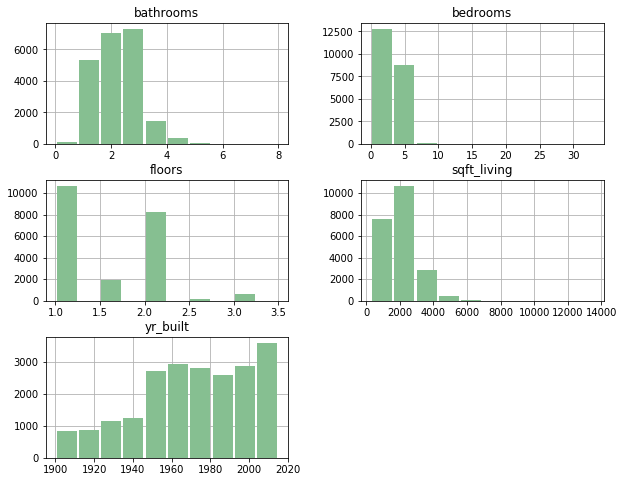

In [8]:
df_refined.hist(figsize=(10,8), color='#86bf91', zorder=2, rwidth=0.9)

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21613 entries, 16768 to 16594
Data columns (total 21 columns):
id               21613 non-null int64
date             21613 non-null object
price            21613 non-null float64
bedrooms         21613 non-null int64
bathrooms        21613 non-null float64
sqft_living      21613 non-null int64
sqft_lot         21613 non-null int64
floors           21613 non-null float64
waterfront       21613 non-null category
view             21613 non-null category
condition        21613 non-null category
grade            21613 non-null category
sqft_above       21613 non-null int64
sqft_basement    21613 non-null int64
yr_built         21613 non-null int64
yr_renovated     21613 non-null int64
zipcode          21613 non-null object
lat              21613 non-null float64
long             21613 non-null float64
sqft_living15    21613 non-null int64
sqft_lot15       21613 non-null int64
dtypes: category(4), float64(5), int64(10), object(2)
memory usag

Using Folium, we will plot the houses on a map
 - Setup a map centered on King County.
 - Add a marker to the map for each house sold in the area.
 - Display the map.

In [10]:
houses_map = folium.Map(location = [df['lat'].mean(), df['long'].mean()], zoom_start = 10)
marker_cluster = folium.plugins.MarkerCluster().add_to(houses_map)
MAX_RECORDS = 100
for name, row in df.iterrows():
    folium.Marker([row["lat"], row["long"]], 
                  popup="Sold for {0}$ on: {1}. Features: {2} sqft, {3} bedrooms, {4} bathrooms, year built: {5}"\
                  .format(row["price"], row["date"], row['sqft_living'], 
                          row['bedrooms'], row['bathrooms'], row['yr_built'])).add_to(marker_cluster)
    
#houses_map.create_map('houses.html')
houses_map.save('houses.html')
houses_map

#### Plotting a HeatMap

In [11]:
houses_heatmap = folium.Map(location = [df['lat'].mean(), df['long'].mean()], zoom_start = 9)
houses_heatmap.add_children(plugins.HeatMap([[row["lat"], row["long"]] for name, row in df.iterrows()]))
houses_heatmap.save("heatmap.html")
houses_heatmap

Heatmaps give good indication of trends and a high level view of the distribution.

However, we’ll want something with more structure to plot out differences in house sale accross the county. Zip codes are a good way to visualize this information.

We could for example compute the mean house price by zip code, then plot this out on a map. In the below code, we'll:

 - group the dataframe by zipcode,
 - Compute the average price of each column
 - add a column with the total number of observations (i.e., house sales) per zipcode

In [12]:
zipcode_data = df.groupby('zipcode').aggregate(np.mean)
zipcode_data.reset_index(inplace=True)

df['count'] = 1
count_houses_zipcode = df.groupby('zipcode').sum()
count_houses_zipcode.reset_index(inplace=True)
count_houses_zipcode = count_houses_zipcode[['zipcode','count']]
df.drop(['count'], axis = 1, inplace = True)

zipcode_data = pd.merge(zipcode_data, count_houses_zipcode, how='left', on=['zipcode'])
zipcode_data.head(2)

,zipcode,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,count
0,98001,4.664787e+09,280804.690608,3.383978,2.006215,1900.856354,14937.450276,1.429558,1721.325967,179.530387,1980.679558,43.801105,47.30902,-122.270646,1828.856354,11214.403315,362
1,98002,4.850894e+09,234284.035176,3.326633,1.839196,1627.743719,7517.633166,1.334171,1522.537688,105.206030,1967.773869,59.889447,47.30878,-122.213357,1479.030151,7585.482412,199


We’ll now be able to plot the average value of a specific attribute for each zip code. In order to do this, we’ll read data in GeoJSON format to get the shape of each zip code, then match each zip code shape with the attribute score. Let's first create a function.

In [13]:
def show_zipcode_map(col):
    geo_path = 'zipcode_king_county.geojson'
    zipcode = folium.Map(location=[df['lat'].mean(), df['long'].mean()], zoom_start=9)
#     zipcode.geo_json(geo_path = geo_path,
#                      df=zipcode_data, 
#                      columns = ['zipcode', col], key_on = 'feature.properties.ZCTA5CE10',
#                  fill_color='OrRd', fill_opacity=0.9,line_opacity=0.2)

    zipcode.choropleth(geo_data = geo_path,
                     data=zipcode_data, 
                     columns = ['zipcode', col], key_on = 'feature.properties.ZCTA5CE10',
                 fill_color='OrRd', fill_opacity=0.9,line_opacity=0.2)
    zipcode.save(col + '.html')
    return zipcode

In [14]:
show_zipcode_map('count')

In [15]:
show_zipcode_map('price')

In [16]:
show_zipcode_map('sqft_living')

In [17]:
show_zipcode_map('yr_built')

### Distribution of the price data - Dependent variable

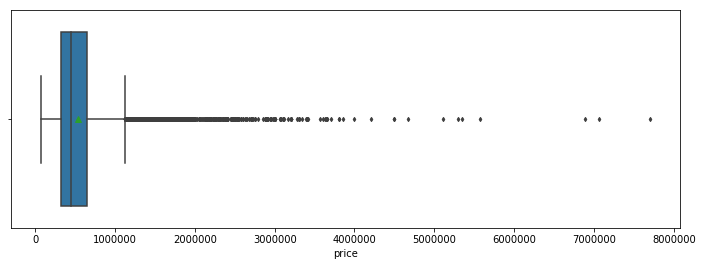

In [18]:
fig, ax = plt.subplots(figsize=(12,4))
sns.boxplot(x = 'price', data = df, orient = 'h', width = 0.8, 
                 fliersize = 3, showmeans=True, ax = ax)
plt.show()

There seems to be a lot of outliers at the top of the distribution, with a few houses above the 5000000 value. 
If we ignore outliers, the range is illustrated by the distance between the opposite ends of the whiskers (1.5 IQR) - about 1000000 here. 
Also, we can see that the right whisker is slightly longer than the left whisker and that the median line is gravitating towards the left of the box. The distribution is therefore slightly skewed to the right.

### Associations and Correlations between Variables

Let's analyze now the relationship between the independent variables available in the dataset and the dependent variable that we are trying to predict (i.e., price).

We'll be using scatterplots and correlations coefficients (e.g., Pearson, Spearman) to explore potential associations between the variables.

##### 4.1 Continuous Variables
For example, let's analyze the relationship between the square footage of a house (sqft_living) and its selling price. Since the two variables are measured on a continuous scale, we can use Pearson's coefficient r to measures the strength and direction of the relationship.

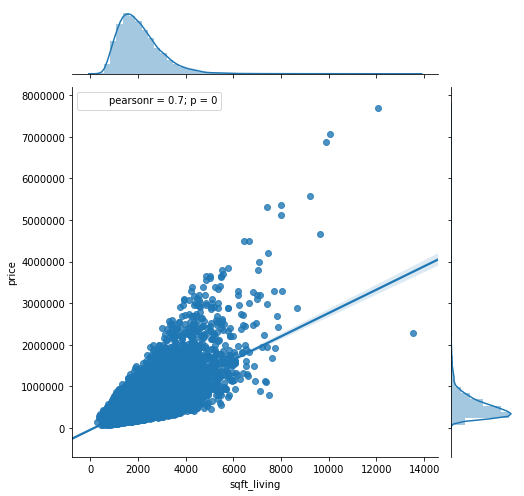

In [19]:
# A joint plot is used to visualize the bivariate distribution
sns.jointplot(x="sqft_living", y="price", data=df, kind = 'reg', size = 7)
plt.show()

There is a clear linear association between the variables (r = 0.7), indicating a strong positive relationship. sqft_living should be a good predicator of house price. (note: sqft_living distribution is also skewed to the right)

Let's do the same with the 7 remaining continuous variables:

 - sqft_lot
 - sqft_above (i.e., sqft_above = sqft_living - sqft_basement)
 - sqft_basement
 - sqft_living15, the average house square footage of the 15 closest neighbours
 - sqft_lot15, the average lot square footage of the 15 closest neighbours
 - yr_built
 - yr_renovated
 - lat
 - long

In [20]:
%%javascript
IPython.OutputArea.auto_scroll_threshold = 9999;
//First, a simple command to increase the maximum size of the output cells in the notebook

<IPython.core.display.Javascript object>

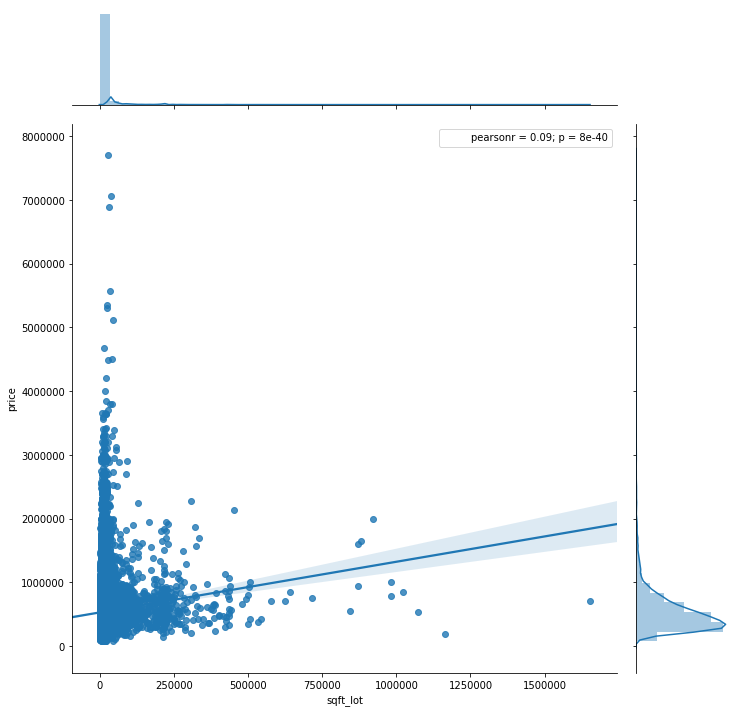

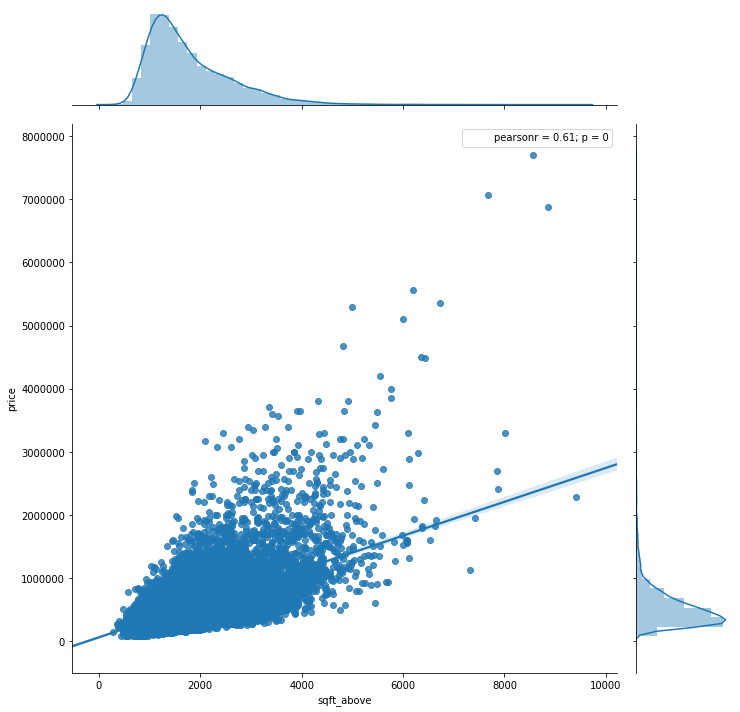

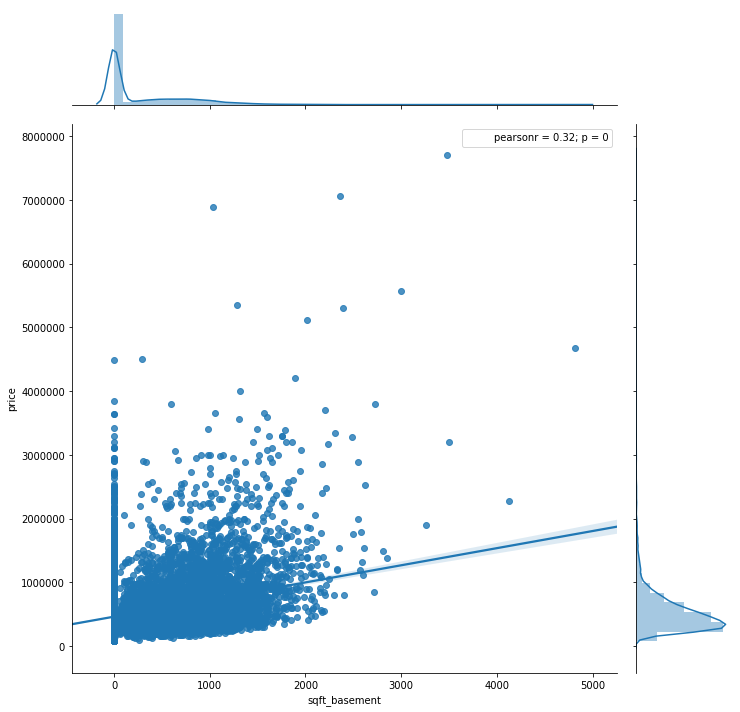

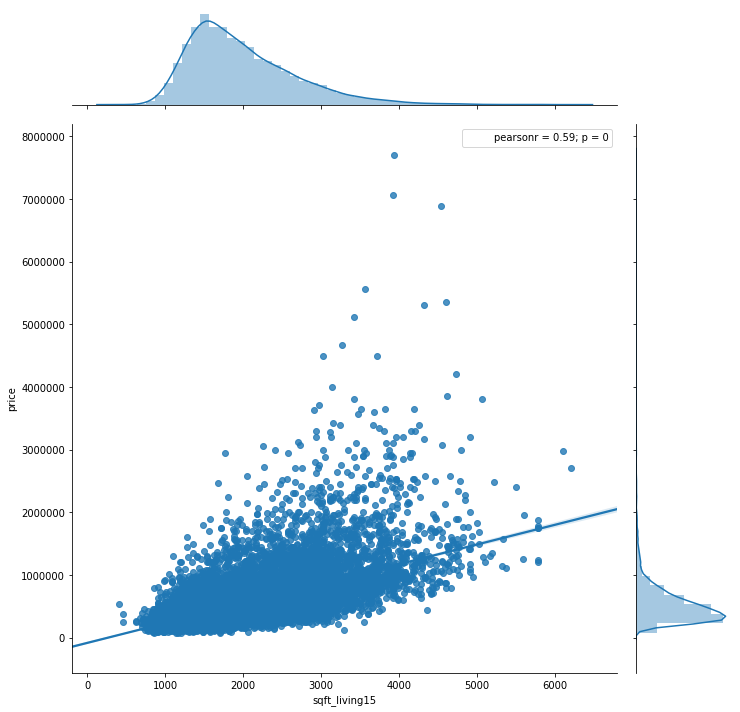

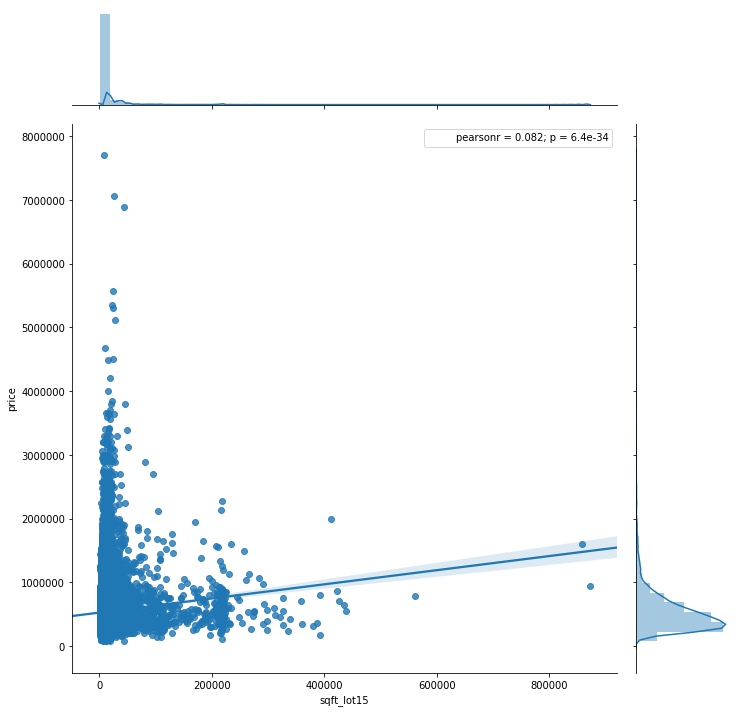

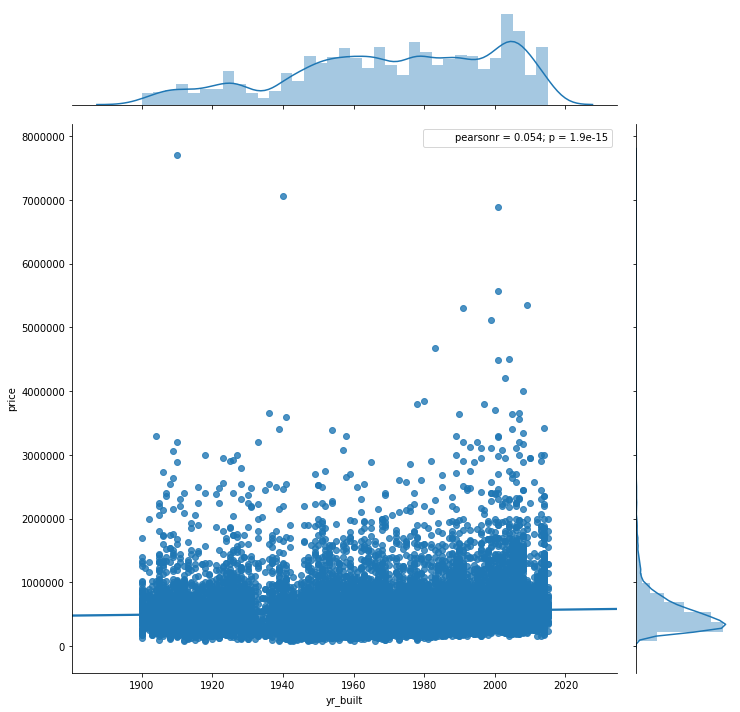

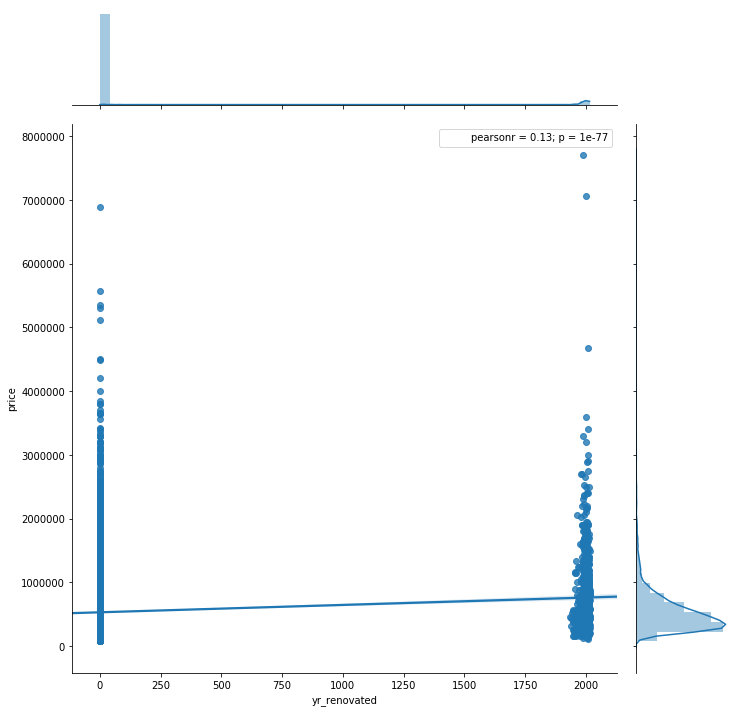

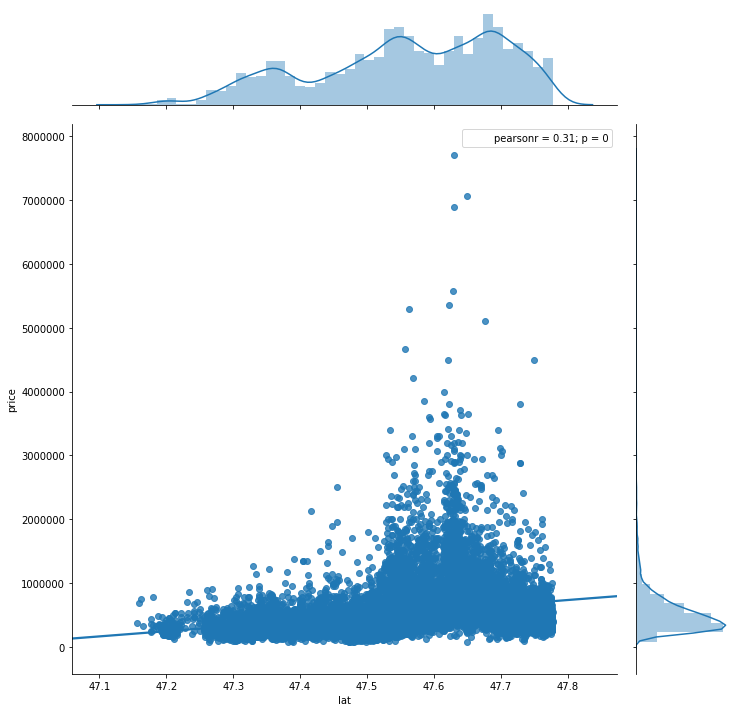

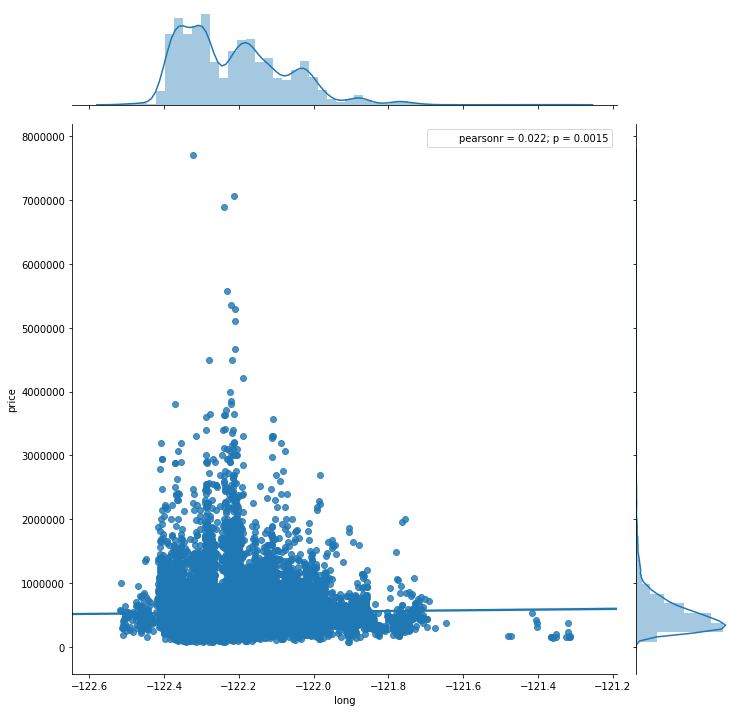

In [21]:
sns.jointplot(x="sqft_lot", y="price", data=df, kind = 'reg', size = 10)
sns.jointplot(x="sqft_above", y="price", data=df, kind = 'reg', size = 10)
sns.jointplot(x="sqft_basement", y="price", data=df, kind = 'reg', size = 10)
sns.jointplot(x="sqft_living15", y="price", data=df, kind = 'reg', size = 10)
sns.jointplot(x="sqft_lot15", y="price", data=df, kind = 'reg', size = 10)
sns.jointplot(x="yr_built", y="price", data=df, kind = 'reg', size = 10)
sns.jointplot(x="yr_renovated", y="price", data=df, kind = 'reg', size = 10)
sns.jointplot(x="lat", y="price", data=df, kind = 'reg', size = 10)
sns.jointplot(x="long", y="price", data=df, kind = 'reg', size = 10)
plt.show()

sqft_lot, sqft_lot15 and yr_built seem to be poorly related to price.

We can see that there is a lot of zeros in the sqft_basement distribution (i.e., no basement). Similarly, there is a lot of zeros in the yr_renovated variable.

Let's rerun the association tests for these two variables without the zeros.

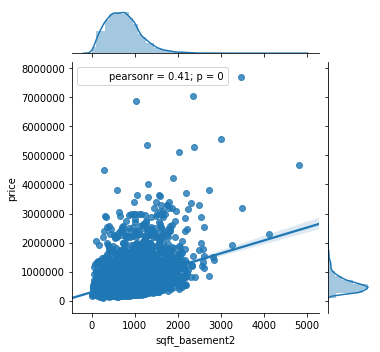

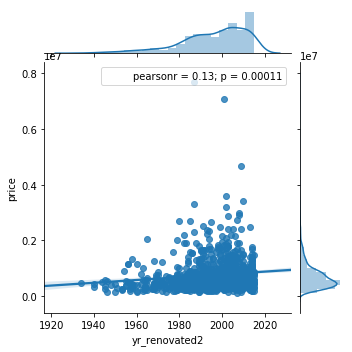

In [22]:
# Create 2 new columns for the analysis 
df['sqft_basement2'] = df['sqft_basement'].apply(lambda x: x if x > 0 else None)
df['yr_renovated2'] = df['yr_renovated'].apply(lambda x: x if x > 0 else None)

# Show the new plots with paerson correlation
sns.jointplot(x="sqft_basement2", y="price", data=df, kind = 'reg', dropna=True, size = 5)
sns.jointplot(x="yr_renovated2", y="price", data=df, kind = 'reg', dropna=True, size = 5)
plt.show()

The house price is moderately correlated with the size of the basement (if basement present). There is also a small correlation with the year of the renovation (if renovated).

We can classify basement and renovation as binary classfier for better analysis and impact on the model. eg : 0 for no basement, 1 for basement present.

Creating new columns for the same

In [23]:
df['basement_present'] = df['sqft_basement'].apply(lambda x: 1 if x > 0 else 0)
df['basement_present'] = df['basement_present'].astype('category', ordered = False)

df['renovated'] = df['yr_renovated'].apply(lambda x: 1 if x > 0 else 0)
df['renovated'] = df['renovated'].astype('category', ordered = False)

We will analyse these new variables as categorical (see in few cells below).

Let's check our independent variables for correlation:
The two variables, sqft_above and sqft_living15. They seem to be strongly related to price. Let's analyse their associations (along with sqft_living) using the pairgrid() function from seaborn. This function creates a matrix of axes and shows the relationship for each pair of the selected variables.

We will draw the univariate distribution of each variable on the diagonal Axes, and the bivariate distributions using scatterplots on the upper diagonal and kernel density estimation on the lower diagonal. We will create a function to display the paerson coefficient of each pair.

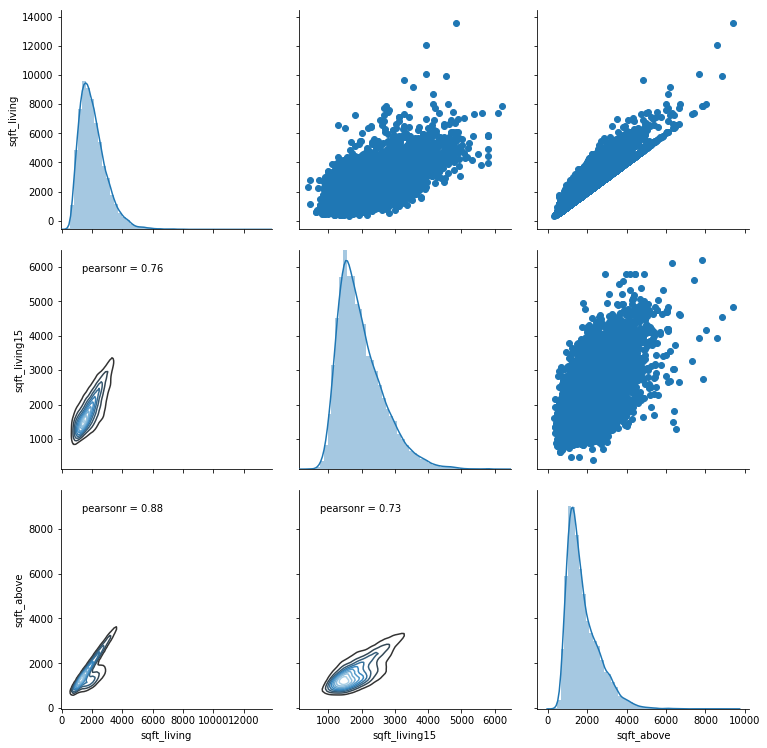

In [24]:
# define a function to display pearson coefficients on the lower graphs 
def corrfunc(x, y, **kws):
    r, _ = stats.pearsonr(x, y)
    ax = plt.gca()
    ax.annotate("pearsonr = {:.2f}".format(r),
                xy=(.1, .9), xycoords=ax.transAxes)

g = sns.PairGrid(df, vars = ['sqft_living', 'sqft_living15', 'sqft_above'], size = 3.5) # define the pairgrid
g.map_upper(plt.scatter) 
g.map_diag(sns.distplot)
g.map_lower(sns.kdeplot, cmap="Blues_d")
g.map_lower(corrfunc)
plt.show()

As expected, there is a strong positive relationship between the 3 variables (r>0.7). It was kind of obvious for sqft_above which is equal to sqft_livng - sqft_basement. So we know that they both have an impact on price.

For sqft_living15 however, we are not sure if the relationship with house price is actually due to the average square footage of the 15th closest houses. This is because of the high correlation between sqft_living15 and sqft_living.

To assess the true relationship between price and sqft_living15, we can use the Pearson Partial Correlation test. The correlation can assess the association between two continuous variables whilst controlling for the effect of other continuous variables called covariates. In our example, we will test the relationship between price and sqft_living15 using sqft_living as covariate.

In [25]:
# a Function to returns the sample linear partial correlation coefficients between pairs of variables in C, controlling 
# for the remaining variables in C (clone of Matlab's partialcorr). 
def partial_corr(C):
    C = np.asarray(C)
    p = C.shape[1]
    P_corr = np.zeros((p, p), dtype=np.float)
    for i in range(p):
        P_corr[i, i] = 1
        for j in range(i+1, p):
            idx = np.ones(p, dtype=np.bool)
            idx[i] = False
            idx[j] = False
            beta_i = linalg.lstsq(C[:, idx], C[:, j])[0]
            beta_j = linalg.lstsq(C[:, idx], C[:, i])[0]
            res_j = C[:, j] - C[:, idx].dot( beta_i)
            res_i = C[:, i] - C[:, idx].dot(beta_j)            
            corr = stats.pearsonr(res_i, res_j)[0]
            P_corr[i, j] = corr
            P_corr[j, i] = corr
    return P_corr

# Convert pandas dataframe to a numpy array using only three columns
partial_corr_array = df.as_matrix(columns = ['price', 'sqft_living', 'sqft_living15'])

# Calculate the partial correlation coefficients
partial_corr(partial_corr_array)


array([[1.        , 0.48387837, 0.06254496],
       [0.48387837, 1.        , 0.7792972 ],
       [0.06254496, 0.7792972 , 1.        ]])

We can see now that the average house size of the surrounding houses has no effect on the sell price when controlling for the size of the house (r = 0.06).

### Categorical Variables

Let's now analyze the relationship between house price and the categorical variables.

We will try to assess if having a waterfront is related to a higher house value. Waterfront is a dichotomous variable with underlying continuous distribution (having a waterfront is better than not having a waterfront). We can use a point-biserial correlation coefficient to highlight the relationship between the two variables.

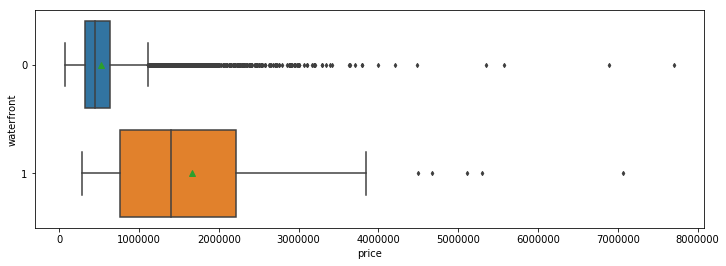

point biserial correlation r is 0.26636943403060215 with p = 0.0


In [26]:
# Let's show boxplots first
fig, ax = plt.subplots(figsize=(12,4))
sns.boxplot(y = 'waterfront', x = 'price', data = df,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = ax)
plt.show()

# Calculate the correlation coefficient
r, p = stats.pointbiserialr(df['waterfront'], df['price'])
print ('point biserial correlation r is %s with p = %s' %(r,p))

Comments:

The no waterfront box plot is comparatively short. This suggests that overall, house prices in this group are very close to each other.
The waterfront box plot is comparatively tall. This suggests that house prices differ greatly in this group.
There is obvious shape differences between the two distributions, suggesting a higher sell price, in general, for houses with a waterfront. This is validated by a positive value of the point-biserial correlation.
The correlation if however small (r<0.3).

We can run the same test on the basement_present variable and whether or not the house had been renovated in the past.

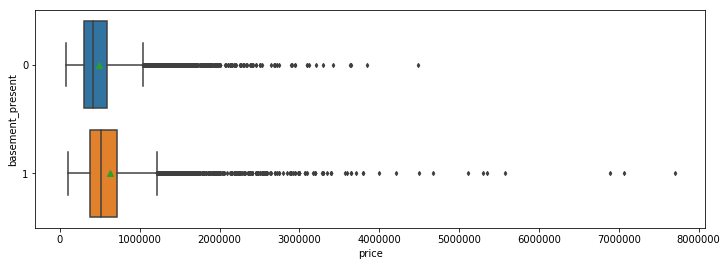

point biserial correlation r between price and basement_present is 0.18023008665021023 with p = 3.2567787361972933e-157



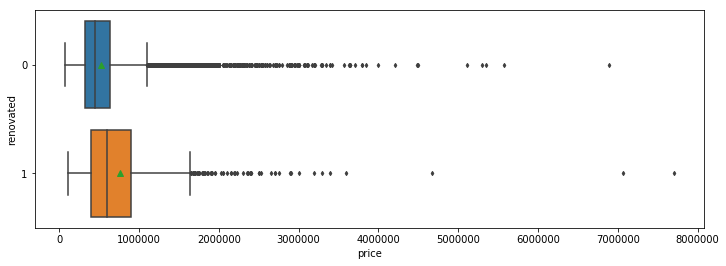

point biserial correlation r between price and renovated is 0.12609226271139484 with p = 2.6401485917732445e-77


In [27]:
# basement_present variable
fig, ax = plt.subplots(figsize=(12,4))
sns.boxplot(y = 'basement_present', x = 'price', data = df,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = ax)
plt.show()
r, p = stats.pointbiserialr(df['basement_present'], df['price'])
print ('point biserial correlation r between price and basement_present is %s with p = %s' %(r,p))

# renovated variable
fig, ax = plt.subplots(figsize=(12,4))
sns.boxplot(y = 'renovated', x = 'price', data = df,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = ax)
print ('')
plt.show()
r, p = stats.pointbiserialr(df['renovated'], df['price'])
print ('point biserial correlation r between price and renovated is %s with p = %s' %(r,p))

Associations exist but they are fairly small (0.1 < r < 0.3).

Let's move on to our ordinal variables and asses their association with house price. We will show the distribution of the categories of each variable using boxplots.

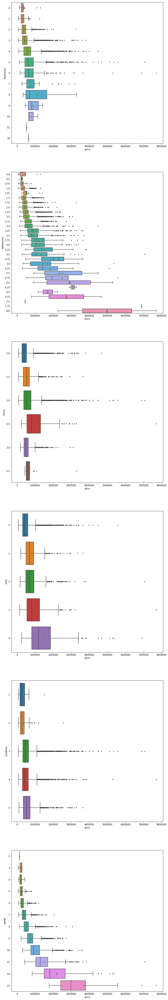

In [28]:
fig, axarr = plt.subplots(6, figsize=(12,80))
sns.boxplot(y = 'bedrooms', x = 'price', data = df,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = axarr[0])
sns.boxplot(y = 'bathrooms', x = 'price', data = df,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = axarr[1])
sns.boxplot(y = 'floors', x = 'price', data = df,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = axarr[2])
sns.boxplot(y = 'view', x = 'price', data = df,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = axarr[3])
sns.boxplot(y = 'condition', x = 'price', data = df,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = axarr[4])
sns.boxplot(y = 'grade', x = 'price', data = df,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = axarr[5])
plt.show()

As expected, they all seem to be related to the house price.

We can use the Spearman's rank-order correlation to measure the strength and direction of the relationships between house price and these variables.

In [29]:
r, p = stats.spearmanr(df['bedrooms'], df['price'])
print ('spearman correlation r between price and bedrooms is %s with p = %s' %(r,p))
r, p = stats.spearmanr(df['bathrooms'], df['price'])
print ('spearman correlation r between price and bathrooms is %s with p = %s' %(r,p))
r, p = stats.spearmanr(df['floors'], df['price'])
print ('spearman correlation r between price and floors is %s with p = %s' %(r,p))
r, p = stats.spearmanr(df['view'], df['price'])
print ('spearman correlation r between price and view is %s with p = %s' %(r,p))
r, p = stats.spearmanr(df['condition'], df['price'])
print ('spearman correlation r between price and condition is %s with p = %s' %(r,p))
r, p = stats.spearmanr(df['grade'], df['price'])
print ('spearman correlation r between price and grade is %s with p = %s' %(r,p))

spearman correlation r between price and bedrooms is 0.34465237095978885 with p = 0.0
spearman correlation r between price and bathrooms is 0.49716035081092047 with p = 0.0
spearman correlation r between price and floors is 0.32234655003563695 with p = 0.0
spearman correlation r between price and view is 0.29393116417024306 with p = 0.0
spearman correlation r between price and condition is 0.018489958301262526 with p = 0.006560828406548436
spearman correlation r between price and grade is 0.6582152214259374 with p = 0.0


There is indeed associations between these variables and the house price (except for condition). grade seems to be the best indicator.

we analyzed the relationship between the output variable (house price) and the dependent variables in our dataset.

More specifically, we highlighted that:

1. sqft_living, sqft_above and sqft_basement were moderately/strongly associated with price. Paerson r was equal to 0.70, 0.61 and 0.41, respectively. The 3 variables were also strongly related to each other as sqft_living = sqft_above and sqft_basement.
2. sqft_living15, the average house square footage of the 15 closest neighbors, was also strongly related to price (r = 0.59) . However, when controlling for sqft_living, the relationship disappeared ( r=0.06 ).
3. sqft_lot, sqft_lot15 (average lot size of the 15 closest houses) and yr_built were poorly related to price.
4. The three dichotomous variables (waterfront, basement_present, renovated) were associated with price. The associations were small (r < 0.3)
5. Five of the ordinal parameters (bedrooms, bathrooms, floors, views, grade) were also moderately to strongly associated with price.
6. Our multiple regression analysis models in Part 2 will be built on these results.

### Let's create a few models now and see how they perform and how well they explain the unknown variance

#### Defining a function to calculate Adjusted R2

In [30]:
def adjustedR2(r2,n,k):
    return r2-(k-1)/(n-k)*(1-r2)

#### Removing some unwanted columns from the data

In [31]:
df_reg = df
df_reg.drop(['id','date', 'sqft_basement2','yr_renovated2'], axis = 1, inplace = True)

#### Encoding dummy variables

    - floors
    - view
    - condition
    - grade

In [32]:
categorical_cols = ['floors', 'view', 'condition', 'grade']

for col in categorical_cols:
    dummies = pd.get_dummies(df_reg[col], drop_first=False)
    dummies = dummies.add_prefix("{}#".format(col))
    df_reg.drop(col, axis=1, inplace=True)
    df_reg = df_reg.join(dummies)

Zipcode is a tricky field to factor in. 

While reviewing a few kernels on this dataset I found one interesting approach as described. We have 70 different zipcodes. We will encode the 6 most expensive zipcodes shown in the map
 

In [33]:
dummies_zip = pd.get_dummies(df_reg['zipcode'], drop_first=False)
dummies_zip.reset_index(inplace=True)
dummies_zip = dummies_zip.add_prefix("{}#".format('zipcode'))
dummies_zip =  dummies_zip[['zipcode#98004','zipcode#98102','zipcode#98109','zipcode#98112','zipcode#98039','zipcode#98040']]
df_reg.drop('zipcode', axis=1, inplace=True)
df_reg = df_reg.join(dummies_zip)

df_reg.dtypes

price                float64
bedrooms               int64
bathrooms            float64
sqft_living            int64
sqft_lot               int64
waterfront          category
sqft_above             int64
sqft_basement          int64
yr_built               int64
yr_renovated           int64
lat                  float64
long                 float64
sqft_living15          int64
sqft_lot15             int64
basement_present    category
renovated           category
floors#1.0             uint8
floors#1.5             uint8
floors#2.0             uint8
floors#2.5             uint8
floors#3.0             uint8
floors#3.5             uint8
view#0                 uint8
view#1                 uint8
view#2                 uint8
view#3                 uint8
view#4                 uint8
condition#1            uint8
condition#2            uint8
condition#3            uint8
condition#4            uint8
condition#5            uint8
grade#1                uint8
grade#3                uint8
grade#4       

In [34]:
df_reg.to_csv('king_county_cleansed.csv')

In [98]:
##Splitting the data in train-test split
from sklearn.cross_validation import train_test_split
train_data, test_data = train_test_split(df_reg, train_size = 0.8, random_state = 10)

### Models begin here
Trying different linear regression models. Also, will try out ridge regression and lasso for regularization

### Simple Linear Regression Models

In [99]:
# A function that take one input of the dataset and return the RMSE (of the test data), and the intercept and coefficient
def simple_linear_model(train, test, input_feature):
    lr = linear_model.LinearRegression()
    X_train = np.array(train_data[input_feature], dtype=pd.Series).reshape(-1,1)
    y_train = np.array(train_data['price'], dtype=pd.Series)
    lr.fit(X_train,y_train)
    X_test = np.array(test_data[input_feature], dtype=pd.Series).reshape(-1,1)
    y_test = np.array(test_data['price'], dtype=pd.Series)
    pred = lr.predict(X_test)
    msesm = format(np.sqrt(metrics.mean_squared_error(y_test,pred)),'.3f')
    rtrsm = format(lr.score(X_train, y_train),'.3f')
    rtesm = format(lr.score(X_test, y_test),'.3f')
    X  = df_reg[input_feature]
    y = df_reg['price']
    X = sm.add_constant(X)
    model = sm.OLS(y,X.astype(float))
    results = model.fit()
    #print(results.summary())
          
    aic = results.aic
    bic = results.bic
    p_val = results.pvalues[1]
    
#     print("aic" + str(aic))
#     print("bic" + str(bic))
#    print("p_val" + str(p_val))

    
    r = evaluation.shape[0]
    evaluation.loc[r] = ['Simple Model','Price vs.' + input_feature,msesm,rtrsm,'-',rtesm,'-', aic, bic]

In [100]:
#simple_linear_model(train_data, test_data, 'sqft_living') # For testing sake.

In [101]:
input_list = df_reg.columns.values.tolist() # list of column name
input_list.remove('price')

# loop that calculate the RMSE of the test data for each input 
for p in input_list:
    #print("Calling for " + p)
    simple_linear_model(train_data, test_data, p)

In [102]:
evaluation.sort_values('R-squared (test)', ascending=False).head(10) # display the 10 best estimators

,Model,Details,Mean Squared Error (MSE),R-squared (training),Adjusted R-squared (training),R-squared (test),Adjusted R-squared (test),AIC,BIC
2,Simple Model,Price vs.sqft_living,252870.779,0.495,-,0.482,-,600538.566582,600554.528682
5,Simple Model,Price vs.sqft_above,279535.640,0.367,-,0.367,-,605339.358800,605355.320901
11,Simple Model,Price vs.sqft_living15,281706.108,0.339,-,0.357,-,606144.720386,606160.682486
1,Simple Model,Price vs.bathrooms,298632.513,0.275,-,0.277,-,608239.481164,608255.443264
21,Simple Model,Price vs.view#0,327314.436,0.128,-,0.132,-,612228.592686,612244.554787
40,Simple Model,Price vs.grade#11,328549.275,0.128,-,0.125,-,612258.939850,612274.901951
39,Simple Model,Price vs.grade#10,328979.217,0.115,-,0.123,-,612544.451852,612560.413952
25,Simple Model,Price vs.view#4,330805.831,0.091,-,0.113,-,613059.645904,613075.608005
0,Simple Model,Price vs.bedrooms,331297.575,0.092,-,0.110,-,613053.501824,613069.463924
9,Simple Model,Price vs.lat,332907.361,0.093,-,0.102,-,613073.276686,613089.238787


sqft_living provides the smallest train error.

### Multiple Regression

Trying out multiple features. Extending the simple linear regession function to achieve the same

In [103]:
# A function that take multiple features as input and return the RMSE (of the test data), and the  intercept and coefficients
def multiple_regression_model(train, test, input_features):
    X_test = np.array(test[input_features], dtype=pd.DataFrame).reshape(-1,1)
    y_test = np.array(test['price'], dtype=pd.Series)
    
    X  = df_reg[input_features]
    y = df_reg['price']
    X = sm.add_constant(X)
    model = sm.OLS(y,X.astype(float))
    results = model.fit()
    print(results.summary())
          
    aic = results.aic
    bic = results.bic
    complex_model = linear_model.LinearRegression()
    complex_model.fit(train[input_features],train['price'])
    pred1 = complex_model.predict(test[input_features])
    msecm1 = format(np.sqrt(metrics.mean_squared_error(y_test,pred1)),'.3f')
    rtrcm1 = format(complex_model.score(train[input_features],train['price']),'.3f')
    artrcm1 = format(adjustedR2(complex_model.score(train[input_features],train['price']),train.shape[0],len(input_features)),'.3f')
    rtecm1 = format(complex_model.score(test[input_features],test['price']),'.3f')
    #artecm1 = format(adjustedR2(complex_model.score(test[input_features],test['price']),test.shape[0],len(input_features)),'.3f')
    artrcm1 = format(adjustedR2(complex_model.score(train[input_features],train['price']),train.shape[0],len(input_features)),'.3f')
    artecm1 = format(adjustedR2(complex_model.score(test[input_features],test['price']),test.shape[0],len(input_features)),'.3f')
    
    r = evaluation.shape[0]
    independent_var = '+'.join(input_features)
    evaluation.loc[r] = ['Complex Model','Price vs ' + independent_var ,msecm1,rtrcm1,artrcm1,rtecm1,artecm1, aic, bic]

### Trying different Multiple regression model

In [104]:
multiple_regression_model(train_data, test_data, ['sqft_living','bathrooms','bedrooms']) # Model 1
multiple_regression_model(train_data, test_data, ['sqft_above','view#0','bathrooms']) # Model 2
multiple_regression_model(train_data, test_data, ['bathrooms','bedrooms']) # Model 3
multiple_regression_model(train_data, test_data, ['view#0','grade#12','bedrooms','sqft_basement']) # Model 4
multiple_regression_model(train_data, test_data, ['sqft_living','bathrooms','view#0']) # Model 5

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.507
Model:                            OLS   Adj. R-squared:                  0.507
Method:                 Least Squares   F-statistic:                     7405.
Date:                Tue, 27 Nov 2018   Prob (F-statistic):               0.00
Time:                        20:29:57   Log-Likelihood:            -2.9996e+05
No. Observations:               21613   AIC:                         5.999e+05
Df Residuals:                   21609   BIC:                         6.000e+05
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
const        7.485e+04   6913.667     10.826      

In [105]:
evaluation.sort_values('R-squared (test)', ascending=False).head(10) # display the 10 best estimators

,Model,Details,Mean Squared Error (MSE),R-squared (training),Adjusted R-squared (training),R-squared (test),Adjusted R-squared (test),AIC,BIC
53,Complex Model,Price vs sqft_living+bathrooms+view#0,244403.629,0.525,0.525,0.516,0.516,599188.462256,599220.386457
49,Complex Model,Price vs sqft_living+bathrooms+bedrooms,250187.922,0.510,0.510,0.493,0.492,599934.622523,599966.546724
2,Simple Model,Price vs.sqft_living,252870.779,0.495,-,0.482,-,600538.566582,600554.528682
50,Complex Model,Price vs sqft_above+view#0+bathrooms,258989.588,0.455,0.454,0.456,0.456,602102.032456,602133.956657
5,Simple Model,Price vs.sqft_above,279535.640,0.367,-,0.367,-,605339.358800,605355.320901
11,Simple Model,Price vs.sqft_living15,281706.108,0.339,-,0.357,-,606144.720386,606160.682486
52,Complex Model,Price vs view#0+grade#12+bedrooms+sqft_basement,296472.038,0.290,0.290,0.288,0.287,607829.309832,607869.215083
51,Complex Model,Price vs bathrooms+bedrooms,297927.581,0.277,0.277,0.281,0.280,608184.404076,608208.347227
1,Simple Model,Price vs.bathrooms,298632.513,0.275,-,0.277,-,608239.481164,608255.443264
21,Simple Model,Price vs.view#0,327314.436,0.128,-,0.132,-,612228.592686,612244.554787


### Trying to fit a polynomial regression to get a better fit

In [106]:
train_data['sqft_living_squared'] = train_data['sqft_living'].apply(lambda x: x**2) # create a new column in train_data
test_data['sqft_living_squared'] = test_data['sqft_living'].apply(lambda x: x**2) # create a new column in test_data
df_reg['sqft_living_squared'] = df_reg['sqft_living'].apply(lambda x: x**2) # create a new column in df_reg
multiple_regression_model(train_data, test_data, ['sqft_living','sqft_living_squared'])

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.533
Model:                            OLS   Adj. R-squared:                  0.533
Method:                 Least Squares   F-statistic:                 1.232e+04
Date:                Tue, 27 Nov 2018   Prob (F-statistic):               0.00
Time:                        20:29:58   Log-Likelihood:            -2.9938e+05
No. Observations:               21613   AIC:                         5.988e+05
Df Residuals:                   21610   BIC:                         5.988e+05
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                1.992e+05   7

In [107]:
evaluation.sort_values('R-squared (test)', ascending=False).head(10) # display the 10 best estimators

,Model,Details,Mean Squared Error (MSE),R-squared (training),Adjusted R-squared (training),R-squared (test),Adjusted R-squared (test),AIC,BIC
53,Complex Model,Price vs sqft_living+bathrooms+view#0,244403.629,0.525,0.525,0.516,0.516,599188.462256,599220.386457
49,Complex Model,Price vs sqft_living+bathrooms+bedrooms,250187.922,0.510,0.510,0.493,0.492,599934.622523,599966.546724
2,Simple Model,Price vs.sqft_living,252870.779,0.495,-,0.482,-,600538.566582,600554.528682
50,Complex Model,Price vs sqft_above+view#0+bathrooms,258989.588,0.455,0.454,0.456,0.456,602102.032456,602133.956657
54,Complex Model,Price vs sqft_living+sqft_living_squared,269580.410,0.555,0.555,0.411,0.411,598770.002680,598793.945831
5,Simple Model,Price vs.sqft_above,279535.640,0.367,-,0.367,-,605339.358800,605355.320901
11,Simple Model,Price vs.sqft_living15,281706.108,0.339,-,0.357,-,606144.720386,606160.682486
52,Complex Model,Price vs view#0+grade#12+bedrooms+sqft_basement,296472.038,0.290,0.290,0.288,0.287,607829.309832,607869.215083
51,Complex Model,Price vs bathrooms+bedrooms,297927.581,0.277,0.277,0.281,0.280,608184.404076,608208.347227
1,Simple Model,Price vs.bathrooms,298632.513,0.275,-,0.277,-,608239.481164,608255.443264


While we can get better performance than simple linear models, a few problems remain.

First, we don't know which feature to select. Obviously some combinations of features will yield smaller RMSE on the test set.
Second, we don't know how many features to select. This is because the more features we incorporate in the train model, the more overfit we get on the train data, resulting in higher error on the test data.


One solution would be to test multiple features combinations and keep the solution with the smallest error value calculated on the test data. However, this is an overly optimistic approach, since the model complexity is selected to minimize the test error (error is biased). A more sophisticated approach is to use two sets for testing our models, i.e. : a validation set and a test set. We select model complexity to minimize error on the validation set and approximate the generalization error based on the test set.

Going through all subsets of features combinations is most often computationally infeasible. For example, having 30 features yield more than 1 billion combinations. Another approach is to use a greedy technique like a forward stepwise algorithm where the best estimator feature is added to the set of already selected features at each iteration. For example, let's pretend that the best single estimator is sqft_living. In the 2nd step of the greedy algorithm, we test all the remaining features one by one in combinations with sqft_living (e.g., sqft_living and bedrooms, sqft_living and waterfront, etc) and select the best combination using training error. At the end, we select the model complexity (number of features) using the validation error and estimate the generalization error using the test set.



In [108]:
# Adding more features into the dataset.

# sqft_living cubed
train_data['sqft_living_cubed'] = train_data['sqft_living'].apply(lambda x: x**3) 
test_data['sqft_living_cubed'] = test_data['sqft_living'].apply(lambda x: x**3) 
df_reg['sqft_living_cubed'] = df_reg['sqft_living'].apply(lambda x: x**3) 

# bedrooms_squared: this feature will mostly affect houses with many bedrooms.
train_data['bedrooms_squared'] = train_data['bedrooms'].apply(lambda x: x**2) 
test_data['bedrooms_squared'] = test_data['bedrooms'].apply(lambda x: x**2)
df_reg['bedrooms_squared'] = df_reg['bedrooms'].apply(lambda x: x**2)


# Taking the log of squarefeet has the effect of bringing large values closer together and spreading out small values.
train_data['log_sqft_living'] = train_data['sqft_living'].apply(lambda x: log(x))
test_data['log_sqft_living'] = test_data['sqft_living'].apply(lambda x: log(x))
df_reg['log_sqft_living'] = df_reg['sqft_living'].apply(lambda x: log(x))




### Interaction Terms

In [109]:
# bedrooms times bathrooms gives what's called an "interaction" feature. It is large when both of them are large.
train_data['bed_bath_rooms'] = train_data['bedrooms']*train_data['bathrooms']
test_data['bed_bath_rooms'] = test_data['bedrooms']*test_data['bathrooms']
df_reg['bed_bath_rooms'] = df_reg['bedrooms']*df_reg['bathrooms']


In [110]:
train_data.shape

(17290, 55)

In [111]:
test_data.shape

(4323, 55)

In [112]:
# split the train_data to include a validation set (train_data2 = 60%, validation_data = 20%, test_data = 20%)
train_data_2, validation_data = train_test_split(train_data, train_size = 0.75, random_state = 50)

In [113]:
# A function that take multiple features as input and return the RMSE (of the train and validation data)
def RMSE(train, validation, features, new_input):
    features_list = list(features)
    features_list.append(new_input)
    regr = linear_model.LinearRegression() # Create a linear regression object
    regr.fit(train.as_matrix(columns = features_list), train.as_matrix(columns = ['price'])) # Train the model
    RMSE_train = mean_squared_error(train.as_matrix(columns = ['price']), 
                              regr.predict(train.as_matrix(columns = features_list)))**0.5 # Calculate the RMSE on train data
    RMSE_validation = mean_squared_error(validation.as_matrix(columns = ['price']), 
                              regr.predict(validation.as_matrix(columns = features_list)))**0.5 # Calculate the RMSE on train data
    return RMSE_train, RMSE_validation 

In [114]:
input_list = train_data_2.columns.values.tolist() # list of column name
input_list.remove('price')

# list of features included in the regression model and the calculated train and validation errors (RMSE)
regression_greedy_algorithm = pd.DataFrame(columns = ['feature', 'train_error', 'validation_error'])  
i = 0
temp_list = []

# a while loop going through all the features in the dataframe
while i < len(train_data_2.columns)-1:
    
    # a temporary dataframe to select the best feature at each iteration
    temp = pd.DataFrame(columns = ['feature', 'train_error', 'validation_error'])
    
    # a for loop to test all the remaining features
    for p in input_list:
        RMSE_train, RMSE_validation = RMSE(train_data_2, validation_data, temp_list, p)
        temp = temp.append({'feature':p, 'train_error':RMSE_train, 'validation_error':RMSE_validation}, ignore_index=True)
        
    temp = temp.sort_values('train_error') # select the best feature using train error
    best = temp.iloc[0,0]
    temp_list.append(best)
    regression_greedy_algorithm = regression_greedy_algorithm.append({'feature': best, 
                                                  'train_error': temp.iloc[0,1], 'validation_error': temp.iloc[0,2]}, 
                                                 ignore_index=True) # add the feature to the dataframe
    input_list.remove(best) # remove the best feature from the list of available features
    i += 1
    
regression_greedy_algorithm

,feature,train_error,validation_error
0,sqft_living_squared,248895.853855,243579.656459
1,lat,228561.992425,224639.240480
2,waterfront,219160.826558,213436.047707
3,view#0,214635.632361,207261.081020
4,sqft_living15,211975.031633,206031.435125
5,yr_built,209336.325461,202194.012402
6,grade#12,207670.566936,202566.093746
7,grade#10,205592.647347,201490.475400
8,grade#11,203563.756469,199223.579974
9,grade#9,200256.703426,197521.056261


We can see that the validation error is minimum when we reach 25 features in the model (condition#4). We stop the selection here even if the training error keeps getting smaller (overfitting).

Let's now calculate an estimation of the generalization error using test_data

In [115]:
greedy_algo_features_list = regression_greedy_algorithm['feature'].tolist()[:24] # select the first 24 features
greedy_algo_features_list


['sqft_living_squared',
 'lat',
 'waterfront',
 'view#0',
 'sqft_living15',
 'yr_built',
 'grade#12',
 'grade#10',
 'grade#11',
 'grade#9',
 'grade#8',
 'grade#13',
 'bathrooms',
 'grade#7',
 'sqft_living_cubed',
 'condition#3',
 'yr_renovated',
 'view#4',
 'long',
 'renovated',
 'condition#5',
 'floors#1.0',
 'floors#2.5',
 'view#2']

In [116]:
test_data.shape

(4323, 55)

In [117]:
multiple_regression_model(train_data_2, test_data, greedy_algo_features_list)
#print ('test error (RMSE) is: %s' %test_error)

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.737
Model:                            OLS   Adj. R-squared:                  0.737
Method:                 Least Squares   F-statistic:                     2524.
Date:                Tue, 27 Nov 2018   Prob (F-statistic):               0.00
Time:                        20:30:55   Log-Likelihood:            -2.9316e+05
No. Observations:               21613   AIC:                         5.864e+05
Df Residuals:                   21588   BIC:                         5.866e+05
Df Model:                          24                                         
Covariance Type:            nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const               -3.726e+07    

In [118]:
evaluation.sort_values('R-squared (test)', ascending=False).head(10) # display the 10 best estimators

,Model,Details,Mean Squared Error (MSE),R-squared (training),Adjusted R-squared (training),R-squared (test),Adjusted R-squared (test),AIC,BIC
55,Complex Model,Price vs sqft_living_squared+lat+waterfront+vi...,205986.426,0.743,0.743,0.656,0.654,586373.538305,586573.064562
53,Complex Model,Price vs sqft_living+bathrooms+view#0,244403.629,0.525,0.525,0.516,0.516,599188.462256,599220.386457
49,Complex Model,Price vs sqft_living+bathrooms+bedrooms,250187.922,0.510,0.510,0.493,0.492,599934.622523,599966.546724
2,Simple Model,Price vs.sqft_living,252870.779,0.495,-,0.482,-,600538.566582,600554.528682
50,Complex Model,Price vs sqft_above+view#0+bathrooms,258989.588,0.455,0.454,0.456,0.456,602102.032456,602133.956657
54,Complex Model,Price vs sqft_living+sqft_living_squared,269580.410,0.555,0.555,0.411,0.411,598770.002680,598793.945831
5,Simple Model,Price vs.sqft_above,279535.640,0.367,-,0.367,-,605339.358800,605355.320901
11,Simple Model,Price vs.sqft_living15,281706.108,0.339,-,0.357,-,606144.720386,606160.682486
52,Complex Model,Price vs view#0+grade#12+bedrooms+sqft_basement,296472.038,0.290,0.290,0.288,0.287,607829.309832,607869.215083
51,Complex Model,Price vs bathrooms+bedrooms,297927.581,0.277,0.277,0.281,0.280,608184.404076,608208.347227


The test error is getting smaller.

Note 1: We could have used k-fold cross validation instead of a validation set.
Note 2: Other greedy algorithms exist (e.g., backward stepwise, combining forward and backward steps)
Now, instead of searching over a discrete set of solutions using greedy algorithms, we can use another technique called regularization. We start with all possible features in the model and shrink the coefficients (weights). Two main regularization techniques exist, Ridge regression (a.k.a L2 regularization) and Lasso regression (a.k.a L1 regularization).

### Regularization

### Ridge Regression
Ridge regression aims to avoid overfitting by adding a cost to the Residual Sum of Squares (RSS) term of standard least squares that depends on the 2-norm of the coefficients. The result is penalizing fits with large coefficients. The strength of this penalty, and thus the fit vs. model complexity, is controlled by a parameter alpha (here called "L2_penalty").

In [119]:
train_data.shape

(17290, 55)

In [120]:
test_data.shape

(4323, 55)

In [121]:
test_data.describe()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,floors#1.0,floors#1.5,floors#2.0,floors#2.5,floors#3.0,floors#3.5,view#0,view#1,view#2,view#3,view#4,condition#1,condition#2,condition#3,condition#4,condition#5,grade#1,grade#3,grade#4,grade#5,grade#6,grade#7,grade#8,grade#9,grade#10,grade#11,grade#12,grade#13,zipcode#98004,zipcode#98102,zipcode#98109,zipcode#98112,zipcode#98039,zipcode#98040,sqft_living_squared,sqft_living_cubed,bedrooms_squared,log_sqft_living,bed_bath_rooms
count,4.323000e+03,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.0,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4323.000000,4.323000e+03,4.323000e+03,4323.000000,4323.000000,4323.000000
mean,5.397433e+05,3.342355,2.115082,2082.113810,14916.303956,1787.704372,294.409438,1971.074717,76.624798,47.561583,-122.213821,1987.826741,13050.135785,0.490632,0.089984,0.378672,0.007402,0.032848,0.000463,0.894980,0.015267,0.048809,0.025908,0.015036,0.001619,0.007865,0.646079,0.266019,0.078418,0.000231,0.0,0.001619,0.010641,0.096461,0.404118,0.292158,0.123757,0.049965,0.016424,0.004164,0.000463,0.017580,0.006246,0.003701,0.012723,0.001619,0.013417,5.191188e+06,1.569448e+10,11.975249,7.551718,7.432050
std,3.512910e+05,0.896716,0.760815,925.304166,34294.477468,828.834716,442.274228,29.343925,383.503205,0.138023,0.142141,696.220749,27626.224210,0.499970,0.286192,0.485112,0.085727,0.178258,0.021507,0.306614,0.122628,0.215493,0.158879,0.121710,0.040212,0.088345,0.478240,0.441925,0.268859,0.015209,0.0,0.040212,0.102616,0.295256,0.490777,0.454807,0.329342,0.217898,0.127113,0.064400,0.021507,0.131436,0.078791,0.060731,0.112088,0.040212,0.115064,5.753806e+06,4.627224e+10,6.416126,0.423391,4.120719
min,8.000000e+04,0.000000,0.000000,290.000000,520.000000,290.000000,0.000000,1900.000000,0.000000,47.155900,-122.511000,460.000000,660.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.410000e+04,2.438900e+07,0.000000,5.669881,0.000000
25%,3.240000e+05,3.000000,1.750000,1440.000000,5000.000000,1190.000000,0.000000,1951.000000,0.000000,47.473700,-122.331000,1490.000000,5080.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.073600e+06,2.985984e+09,9.000000,7.272398,4.500000
50%,4.500000e+05,3.000000,2.250000,1920.000000,7665.000000,1560.000000,0.000000,1975.000000,0.000000,47.572300,-122.234000,1840.000000,7639.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.686400e+06,7.077888e+09,9.000000,7.560080,7.000000
75%,6.415000e+05,4.000000,2.500000,2520.000000,10850.500000,2220.000000,560.000000,1997.000000,0.000000,47.677700,-122.124000,2350.000000,10192.500000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,0

In [122]:
train_data_2, validation_data = train_test_split(train_data, train_size = 0.75, random_state = 50)

Let's test two models using alpha equal 1 and 10.

In [123]:
input_feature = train_data.columns.values.tolist() # list of column name
input_feature.remove('price')
#input_feature


for i in [1,10]:
    ridge = linear_model.Ridge(alpha = i, normalize = True) # initialize the model
    ridge.fit(train_data.as_matrix(columns = input_feature), train_data.as_matrix(columns = ['price'])) # fit the train data

    
    mse = mean_squared_error(test_data.as_matrix(columns = ['price']).astype(np.int), 
                             ridge.predict(test_data.as_matrix(columns = [input_feature]).astype(np.int)))
    print ('test error (RMSE) is:' + str(mse))

test error (RMSE) is:5.069278768212961e+50
test error (RMSE) is:4.972017764610468e+49


### Do cross validation

Ridge Cross Validation

In [124]:
ridgeCV = linear_model.RidgeCV(alphas = np.linspace(1.0e-10,1,num = 100), normalize = True, store_cv_values = True) # initialize the model
ridgeCV.fit(train_data.as_matrix(columns = input_feature), train_data.as_matrix(columns = ['price'])) # fit the train data
print ('best alpha is: %s' %ridgeCV.alpha_) # get the best alpha
print ('test error (RMSE) is: %s' %mean_squared_error(test_data.as_matrix(columns = ['price']).astype(int), 
                              ridgeCV.predict(test_data.as_matrix(columns = [input_feature]).astype(int)))**0.5) # predict price and test error

best alpha is: 0.0303030304
test error (RMSE) is: 3.1291454856938556e+25


As alpha increases, the number of features included in the model decrease. As in Ridge regression, we also can use cross-validation methods that select the best alpha to provide the best predictive accuracy. However, this technique tends to favor less sparse solutions and smaller alpha than optimal choice for feature selection.

### k-Nearest Neighbors (NN) Regression
To finish, let's try another regression model, k-NN regression. The k-NN algorithm is used for estimating continuous variables. One such algorithm uses a weighted average of the k nearest neighbors, weighted by the inverse of their distance. It is the nonparamtric equivalent of ordinary least square regression.

In [125]:
# normalize the data
train_X = train_data.as_matrix(columns = input_feature)
scaler = preprocessing.StandardScaler().fit(train_X)
train_X_scaled = scaler.transform(train_X)
test_X = test_data.as_matrix(columns = [input_feature]).astype(int)
test_X_scaled = scaler.transform(test_X)

knn = neighbors.KNeighborsRegressor(n_neighbors=10, weights='distance') # initialize the model
knn.fit(train_X_scaled, train_data.as_matrix(columns = ['price']).astype(int)) # fit the train data
print ('test error (RMSE) is: %s' %mean_squared_error(test_data.as_matrix(columns = ['price']).astype(int), 
                              knn.predict(test_X_scaled))**0.5) # predict price and test error

test error (RMSE) is: 419861.7542130962


Similarly, the number of neighbor k is related to the complexity of the regression model. We can optimize the model accuracy by running cross-validation on the number of k-neighbors to include.

### Citations
I have thoroughly read different Kaggle notebooks on this data set in Python and R and tried to incorporate the key features from their notebooks.
https://www.kaggle.com/harlfoxem/housesalesprediction

### Fin.